In [19]:
import os
from glob import glob
import pandas as pd
from datetime import datetime
import numpy as np
from tqdm import tqdm
import math
from scipy import signal
import random
import torch

/home/yhbedoya/VirtualEnvs/SHMmae_venv/lib/python3.7/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


List of files

In [20]:
PATH= './traffic'
files = glob(PATH + '/**/*.csv', recursive=True)


In [21]:
names = map(lambda x: x.split('/')[-1], files)
dates = map(lambda x: datetime.strptime(x, 'traffic_%Y%m%dH%H%M%S.csv'), list(names))
dates = list(dates)

In [22]:
oneFile = pd.read_csv('./traffic/traffic_20211205H235907.csv')
sensors = oneFile.sens_pos.unique()

In [23]:
filesDf = pd.DataFrame(
    {'files': files,
     'dates': dates,
    })

filesDf.sort_values(by=['dates'], inplace=True)

In [25]:
batchSize = 10
window_len = 500 #in frames 5 seconds * 100 rates
window_step = 100
totalBatches = int(filesDf.shape[0]/batchSize)
outputs = []
FRAME_SIZE = 128 #in frames
HOP_SIZE = 32
sr = 100
count = 0

for i in range(totalBatches):
    print(f'Start batch {i+1} from {totalBatches}')
    batch = list(filesDf.iloc[i*batchSize:i*batchSize + batchSize]['files'])

    ldf = list()
    for p in batch:
        df_tmp = pd.read_csv(p)
        c_drop = set(df_tmp.columns) - set(["sens_pos", "z", "ts"])
        if len(c_drop) > 0:
            df_tmp.drop(columns=list(c_drop), inplace=True)
        ldf.append(df_tmp)

    df = pd.concat(ldf).sort_values(by=['sens_pos', 'ts'])
    df.reset_index(inplace=True, drop=True)

    #df = df[df['sens_pos'].isin(sensors)]
    df['ts'] = pd.to_datetime(df['ts'], unit='ms')
    for sensor in tqdm(sensors):
        dfS = df[df['sens_pos']==sensor]
        signald = np.array(dfS['z'])
        signalN = signald-np.mean(signald)
        totalWindows = math.floor((len(signalN)-window_len)/window_step)
        for index in range(totalWindows):
            count += 1
            slide = signalN[index*window_step:(index*window_step)+window_len]
            frequencies, times, spectrogram = signal.spectrogram(signalN,sr,nfft=FRAME_SIZE,noverlap=(FRAME_SIZE - HOP_SIZE), nperseg=FRAME_SIZE,mode='psd')
            if random.random() <= 0.001:
                outputs.append((frequencies, times, spectrogram))
            x = torch.tensor(spectrogram)
            torch.save(x, f'./trafficTensors/{sensor}_{i}_{index}.pt')

print(count)

Start batch 1 from 3


100%|██████████| 105/105 [00:23<00:00,  4.45it/s]


Start batch 2 from 3


100%|██████████| 105/105 [00:27<00:00,  3.78it/s]


Start batch 3 from 3


100%|██████████| 105/105 [00:26<00:00,  3.97it/s]

186569


/home/yhbedoya/VirtualEnvs/SHMmae_venv/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


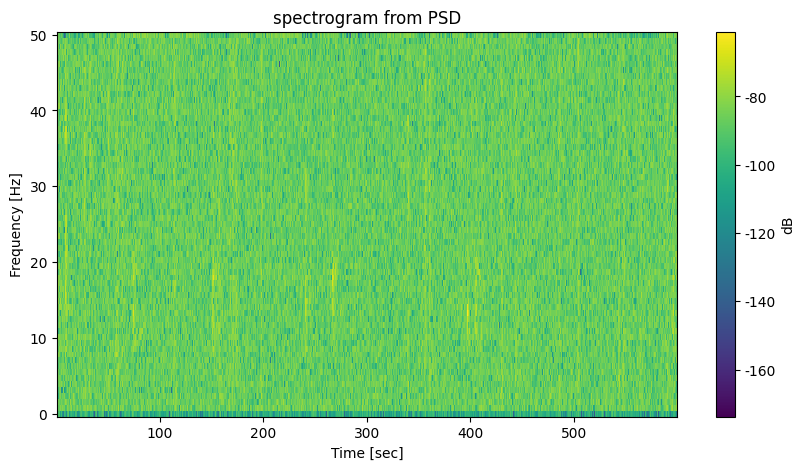

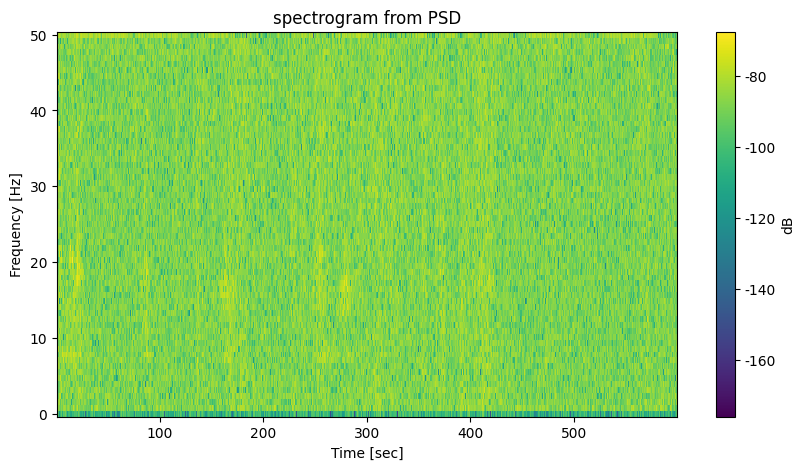

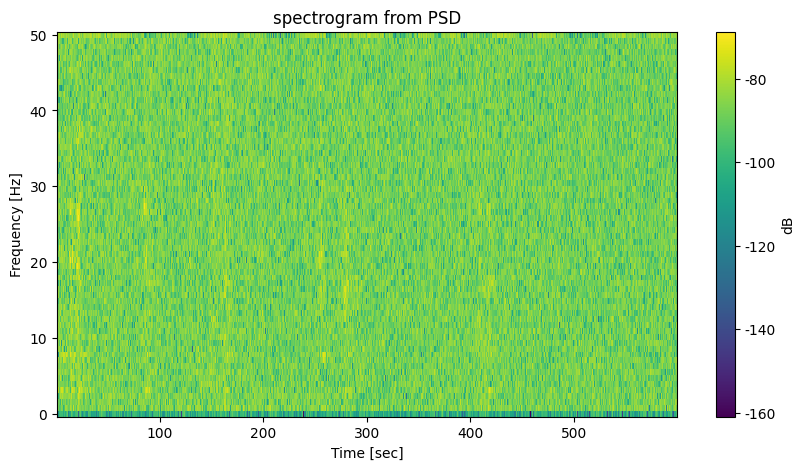

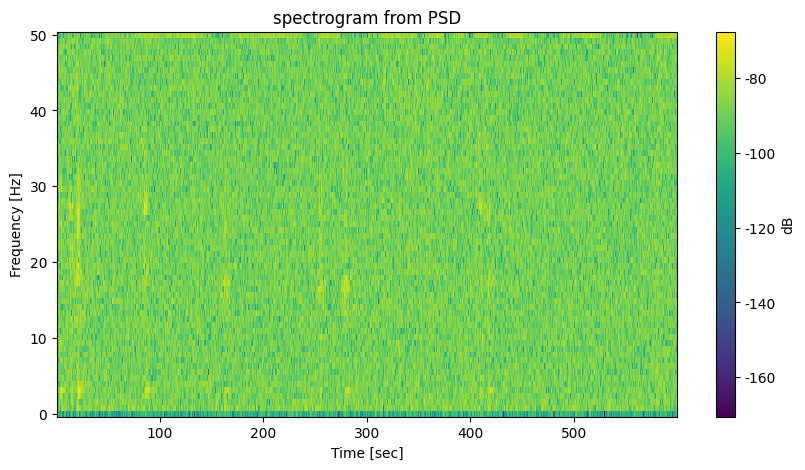

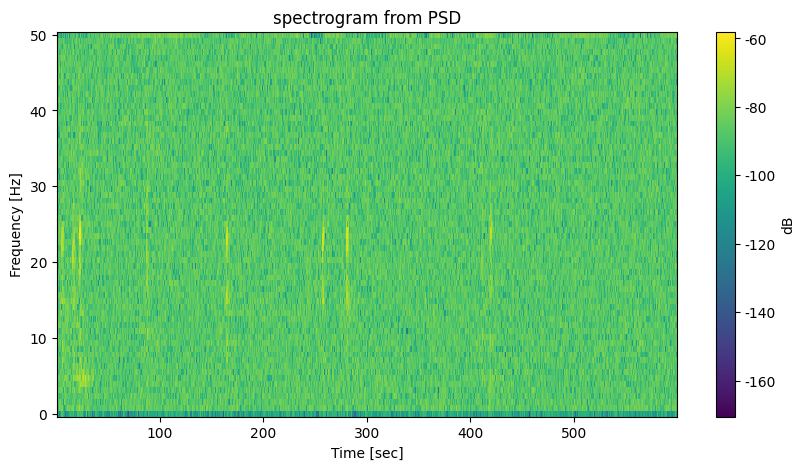

...

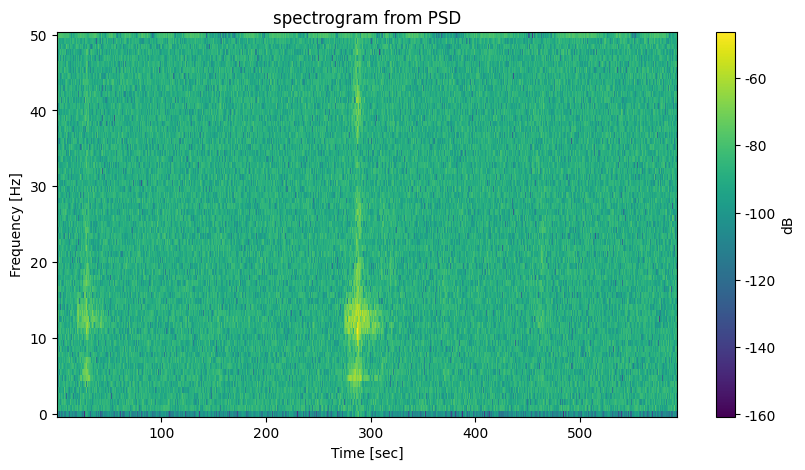

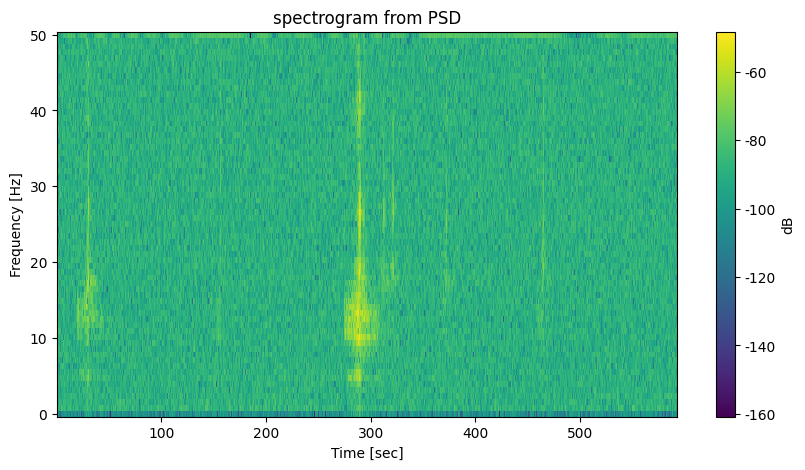

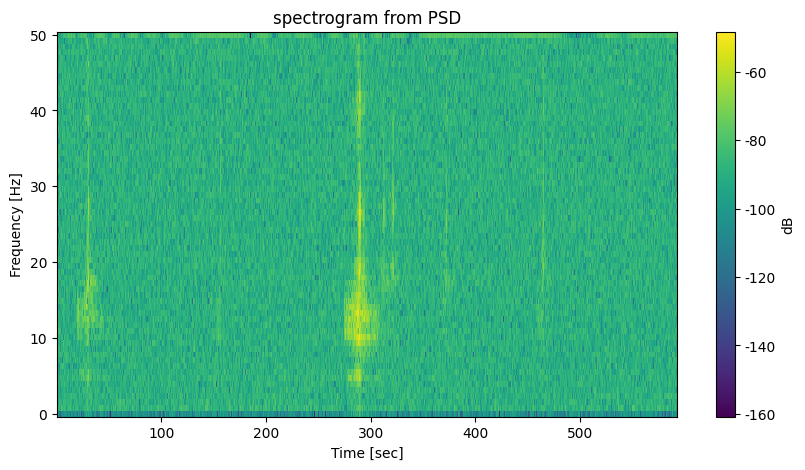

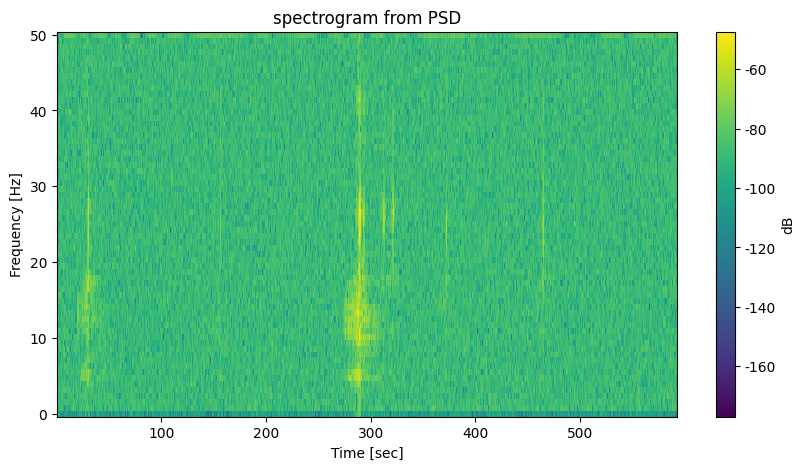

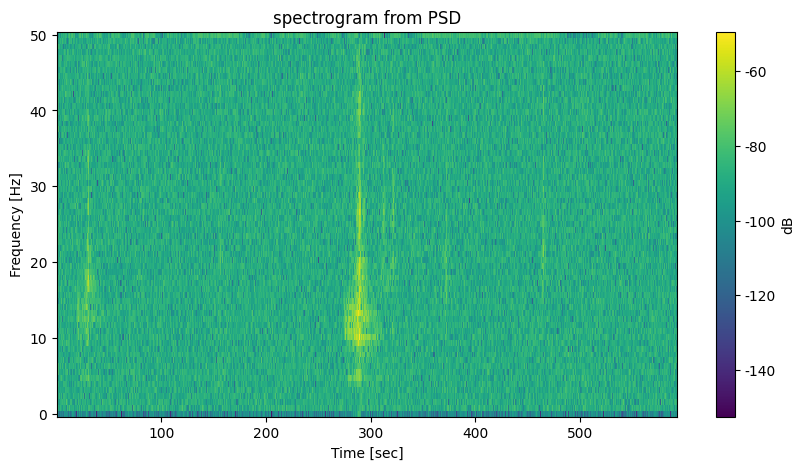

In [18]:
import matplotlib.pyplot as plt
for output in outputs:
    frequencies, times, spectrogram = output

    plt.figure(figsize=(10, 5))
    plt.title('spectrogram from PSD')
    plt.pcolormesh(times, frequencies, 10*np.log10(spectrogram))
    plt.ylabel('Frequency [Hz]')
    plt.xlabel('Time [sec]')
    plt.colorbar(format="%+2.f", label='dB')